# Capstone Week 5

## Importing Libraries

In [102]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

import wikipedia as wp

import geocoder as geocoder
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

from bs4 import BeautifulSoup

import requests # library to handle requests
from pandas import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

#!pip install shapely
import shapely.geometry

#!pip install pyproj
import pyproj

import math

print('Libraries imported.')

Libraries imported.


## Web Scraping Wikipedia

In [103]:
html = wp.page("List of areas of London").html().encode("UTF-8")
df_london_1 = pd.read_html(html)[1]
df_london_1.head()

,Location,London borough,Post town,Postcode district,Dial code,OS grid ref
0,Abbey Wood,"Bexley, Greenwich [7]",LONDON,SE2,020,TQ465785
1,Acton,"Ealing, Hammersmith and Fulham[8]",LONDON,"W3, W4",020,TQ205805
2,Addington,Croydon[8],CROYDON,CR0,020,TQ375645
3,Addiscombe,Croydon[8],CROYDON,CR0,020,TQ345665
4,Albany Park,Bexley,"BEXLEY, SIDCUP","DA5, DA14",020,TQ478728


In [104]:
df_london_1.columns

Index(['Location', 'London borough', 'Post town', 'Postcode district',
       'Dial code', 'OS grid ref'],
      dtype='object')

In [105]:
df_london_1.columns = ['Location','London_borough','Post town','Postcode district','Dial Code','OS grid ref']

### Cleaning The Table
The table contains hyperlinks numbers and there are more than one Postal codes so I decided to keep one.

In [106]:
df_london_1['London_borough'] =  df_london_1['London_borough'].apply(lambda x: x.replace('[','').replace(']','')) 
df_london_1['London_borough'] =  df_london_1['London_borough'].str.replace('\d+', '')
df_london_1['London_borough'] =  df_london_1['London_borough'].str.split(',').str[0]
df_london_1['Postcode district'] =  df_london_1['Postcode district'].str.split(',').str[0]
df_london_1['Postcode district'] =  df_london_1['Postcode district'].str.split('(').str[0]
df_london_1['Post town'] =  df_london_1['Post town'].str.split(',').str[0]

In [107]:
df_london_1.head()

,Location,London_borough,Post town,Postcode district,Dial Code,OS grid ref
0,Abbey Wood,Bexley,LONDON,SE2,020,TQ465785
1,Acton,Ealing,LONDON,W3,020,TQ205805
2,Addington,Croydon,CROYDON,CR0,020,TQ375645
3,Addiscombe,Croydon,CROYDON,CR0,020,TQ345665
4,Albany Park,Bexley,BEXLEY,DA5,020,TQ478728


In [108]:
df_london_1.shape

(533, 6)

## Getting property data of London
This time it was not a wikipedia page so I use pandas read_html function to scrape data.

In [109]:
source = requests.get('https://propertydata.co.uk/cities/london').text 
bsoup = BeautifulSoup(source, 'html5lib')

In [110]:
table_post = bsoup.find('table')
fields = table_post.find_all('td')

Area = []
Avg_yield = []
Avg_price = []
pound_per_sqft = []
five_year = []
Explore_data = []

for i in range(0, len(fields), 6):
    Area.append(fields[i].text.strip())
    Avg_yield.append(fields[i+1].text.strip())
    Avg_price.append(fields[i+2].text.strip())
    pound_per_sqft.append(fields[i+3].text.strip())
    five_year.append(fields[i+4].text.strip())
    Explore_data.append(fields[i+5].text.strip())
        
df_london_2 = pd.DataFrame(data=[Area,Avg_yield,Avg_price,pound_per_sqft,five_year,Explore_data]).transpose()
header_row = 0
df_london_2.columns = df_london_2.iloc[header_row]
df_london_2 = df_london_2.drop(header_row)
df_london_2 = df_london_2.reset_index(drop=True)
df_london_2

,Area,Avg yield,Avg price,£/sqft,5yr +/-,Explore data
0,BR1,3.6%,"£434,986",£462,+23%,Explore data
1,BR2,3.0%,"£510,478",£476,+24%,Explore data
2,BR3,3.4%,"£455,860",£493,+24%,Explore data
3,BR5,3.3%,"£450,548",£428,+25%,Explore data
4,BR6,3.3%,"£544,548",£469,+24%,Explore data
5,BR7,3.0%,"£594,775",£495,+22%,Explore data
6,BR8,-,"£358,796",£357,+26%,Explore data
7,CR0,3.9%,"£347,577",£442,+21%,Explore data
8,CR2,3.7%,"£377,732",£447,+21%,Explore data
9,CR4,3.6%,"£392,993",£431,+19%,Explore data


### Cleaning Property Data
Firstly removed unwanted columns then price was in string format so '£' and commas to be removed

In [111]:
df_london_2.drop(columns=['Avg yield','£/sqft','5yr +/-','Explore data'],inplace=True)
df_london_2

,Area,Avg price
0,BR1,"£434,986"
1,BR2,"£510,478"
2,BR3,"£455,860"
3,BR5,"£450,548"
4,BR6,"£544,548"
5,BR7,"£594,775"
6,BR8,"£358,796"
7,CR0,"£347,577"
8,CR2,"£377,732"
9,CR4,"£392,993"


In [112]:
df_london_2['Avg price'] = df_london_2['Avg price'].str.replace("£","")
df_london_2['Avg price'] = df_london_2['Avg price'].str.replace(',', '')
df_london_2['Avg price'] = pd.to_numeric(df_london_2['Avg price'])

In [113]:
df_london_2.columns=['Postcode district','Avg price']
df_london_2

,Postcode district,Avg price
0,BR1,434986
1,BR2,510478
2,BR3,455860
3,BR5,450548
4,BR6,544548
5,BR7,594775
6,BR8,358796
7,CR0,347577
8,CR2,377732
9,CR4,392993


## Merge the table of London Boroughs and London House Prices
I have done inner joint because there were many postcodes that were not in the London Borough's table.I have also removed unwanted columns.

In [114]:
data=pd.merge(df_london_1,df_london_2 , how='inner', left_on='Postcode district', right_on='Postcode district')
data.drop(columns=['Post town','Dial Code','OS grid ref'],inplace=True)
data

,Location,London_borough,Postcode district,Avg price
0,Abbey Wood,Bexley,SE2,368814
1,Crossness,Bexley,SE2,368814
2,West Heath,Bexley,SE2,368814
3,Acton,Ealing,W3,547488
4,Addington,Croydon,CR0,347577
5,Addiscombe,Croydon,CR0,347577
6,Coombe,Croydon,CR0,347577
7,Croydon,Croydon,CR0,347577
8,Forestdale,Croydon,CR0,347577
9,New Addington,Croydon,CR0,347577


## Finding Longitude and Latitude of the Locations

In [115]:
def getLatLong(row):
    #print('post :{}'.format(row[:]))
    #print('neigh :{}'.format(row[1]))
    # initialize your variable to None
    lat_lng_coords = None
    search_query = '{}, London,UK'.format(row)
    # loop until you get the coordinates
    try:
        while(lat_lng_coords is None):
            #g = geocoder.here(search_query,app_id=app_id,app_code=app_code)
            g = geocoder.arcgis(search_query)
            lat_lng_coords = g.latlng
            #print('FIRST')
    except IndexError:
        latitude = 0.0
        longitude = 0.0
        print('BACKUP')
        return [latitude,longitude]

    latitude = lat_lng_coords[0]
    longitude = lat_lng_coords[1]
    print(latitude, longitude)
    return [latitude, longitude]

In [116]:
coords_list = data['Postcode district'].apply(getLatLong).tolist()

51.492450000000076 0.12127000000003818
51.492450000000076 0.12127000000003818
51.492450000000076 0.12127000000003818
51.51324000000005 -0.2674599999999714
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.38475500000004 -0.051498623999975734
51.50642000000005 -0.1272099999999341
51.50642000000005 -0.1272099999999341
51.50642000000005 -0.1272099999999341
51.51651000000004 -0.11967999999995982
51.51651000000004 -0.11967999999995982
51.51651000000004 -0.11967999999995982
51.51651000000004 -0.11967999999995982
51.50642000000005 -0.1272099999999341
51.50642000000005 -0.1272099999999341
51.50642000000005 -0.1272099999999341
51.41009000000008 -0.05682999999993399
51.41009000000008 -0.05682999999993399
51.523610000000076 -0.0

### Adding Latitude and Longitude to Dataset

In [117]:
data[['Latitude','Longitude']]=pd.DataFrame(coords_list,columns=['Latitude', 'Longitude'])
data.head()

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude
0,Abbey Wood,Bexley,SE2,368814,51.492450,0.121270
1,Crossness,Bexley,SE2,368814,51.492450,0.121270
2,West Heath,Bexley,SE2,368814,51.492450,0.121270
3,Acton,Ealing,W3,547488,51.513240,-0.267460
4,Addington,Croydon,CR0,347577,51.384755,-0.051499


## Map of London

In [119]:
address = 'London'

geolocator = Nominatim(user_agent="ldn_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of London are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of London are 51.5073219, -0.1276474.


In [120]:
london_boroughs_url = 'https://skgrange.github.io/www/data/london_boroughs.json'
london_boroughs = requests.get(london_boroughs_url).json()

def boroughs_style(feature):
    return { 'color': '#ff5a5a', 'fill': False }

In [121]:
map_london = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(data['Latitude'], data['Longitude'], data['London_borough'], data['Location']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_london)

folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_london)
    
map_london

## Using Four API to explore neighborhoods

In [128]:
CLIENT_ID = 'RW42013KYM5TUQ1N5Q0SSN0WJJP3KSLAJI3EBA2GUBXFNHJ1' # your Foursquare ID
CLIENT_SECRET = 'QFWYDMWXNYN20HNQKEOOL5HK3HXQ03VHNKGBTYWFG15FDM5S' # your Foursquare Secret
VERSION = '20200428'

In [129]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        LIMIT=100
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [131]:
london_venues = getNearbyVenues(names=data['Location'], 
                                   latitudes=data['Latitude'], 
                                   longitudes=data['Longitude'], 
                                   radius=500)

Abbey Wood
Crossness
West Heath
Acton
Addington
Addiscombe
Coombe
Croydon
Forestdale
New Addington
Shirley
Waddon
Woodside
Aldborough Hatch
Gants Hill
Newbury Park
Aldwych
Charing Cross
Covent Garden
St Giles
Alperton
Sudbury
Wembley
Anerley
Penge
Angel
Barbican
Clerkenwell
Farringdon
Finsbury
St Luke's
Aperfield
Biggin Hill
Archway
Upper Holloway
Ardleigh Green
Emerson Park
Hornchurch
Arkley
Barnet (also Chipping Barnet, High Barnet)
Monken Hadley
Temple Fortune
Arnos Grove
Bounds Green
Brunswick Park
Colney Hatch
Friern Barnet
New Southgate
Balham
Bankside
Bermondsey
Elephant and Castle
Lambeth
Newington
Barking
Creekmouth
Barkingside
Barnehurst
Barnes
Castelnau
Barnes Cray
Crayford
Barnet Gate
The Hale
Mill Hill
Barnsbury
Canonbury
De Beauvoir Town
Hoxton
Islington
Pentonville
Shoreditch
Battersea
Bayswater
Paddington
Beckenham
Bickley
Bromley Common
Eden Park
Elmers End
Beckton
East Ham
Upton Park
Becontree
Castle Green
Dagenham
Becontree Heath
Beddington
Wallington
Bedford Park
Ch

In [132]:
print(london_venues.shape)
london_venues.head()

(17211, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbey Wood,51.49245,0.12127,Lesnes Abbey,51.489526,0.125839,Historic Site
1,Abbey Wood,51.49245,0.12127,Sainsbury's,51.492824,0.120724,Supermarket
2,Abbey Wood,51.49245,0.12127,Lidl,51.496152,0.118417,Supermarket
3,Abbey Wood,51.49245,0.12127,Abbey Wood Railway Station (ABW),51.490825,0.123432,Train Station
4,Abbey Wood,51.49245,0.12127,Platform 1,51.491023,0.119491,Platform


In [134]:
london_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbey Wood,7,7,7,7,7,7
Acton,7,7,7,7,7,7
Addington,2,2,2,2,2,2
Addiscombe,2,2,2,2,2,2
Aldborough Hatch,61,61,61,61,61,61
Aldwych,90,90,90,90,90,90
Alperton,61,61,61,61,61,61
Anerley,6,6,6,6,6,6
Angel,80,80,80,80,80,80


In [135]:
print('There are {} uniques categories.'.format(len(london_venues['Venue Category'].unique())))

There are 317 uniques categories.


## Analyze venues in each area

In [136]:
# one hot encoding
london_onehot = pd.get_dummies(london_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
london_onehot['Neighborhood'] = london_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [london_onehot.columns[-1]] + list(london_onehot.columns[:-1])
london_onehot = london_onehot[fixed_columns]

london_onehot.head()

,Neighborhood,Adult Boutique,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bar,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bike Shop,Bistro,Boarding House,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brasserie,Brazilian Restaurant,Breakfast Spot,Brewery,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Camera Store,Canal,Candy Store,Caribbean Restaurant,Caucasian Restaurant,Cemetery,Champagne Bar,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Church,Circus School,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Quad,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Costume Shop,Coworking Space,Creperie,Cricket Ground,Cupcake Shop,Currywurst Joint,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dog Run,Doner Restaurant,Donut Shop,Eastern European Restaurant,Electronics Store,English Restaurant,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Forest,Fountain,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Herbs & Spices Store,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hotel,Hotel Bar,Hungarian Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Malay Restaurant,Market,Massage Studio,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Monument / Landmark,Moroccan Restaurant,Motorcycle Shop,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nail Salon,Nature Preserve,New American Restaurant,Nightclub,Noodle House,North Indian Restaurant,Office,Okonomiyaki Restaurant,Opera House,Optical Shop,Organic Grocery,Other Repair Shop,Outdoor Sculpture,Outdoor Supply Store,Pakistani Restaurant,Palace,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Platform,Playground,Plaza,Polish Restaurant,Pool,Portuguese Restaurant,Pub,Racetrack,Radio Station,Ramen Restaurant,Record Shop,Recording Studio,Recreation Center,Recruiting Agency,Rental Car Location,Reservoir,Residential Building (Apartment / Condo),Restaurant,River,Road,Rock Club,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skate Park,Snack Place,Soccer Field,Soccer Stadium,Social Club,Soup Place,South American Restaurant,South Indian Restaurant,Southern / Soul Food Restaurant,Souvenir Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,S

In [137]:
london_onehot.shape

(17211, 318)

In [138]:
london_grouped = london_onehot.groupby('Neighborhood').mean().reset_index()
london_grouped

,Neighborhood,Adult Boutique,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bar,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bike Shop,Bistro,Boarding House,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brasserie,Brazilian Restaurant,Breakfast Spot,Brewery,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Camera Store,Canal,Candy Store,Caribbean Restaurant,Caucasian Restaurant,Cemetery,Champagne Bar,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Church,Circus School,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Quad,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Costume Shop,Coworking Space,Creperie,Cricket Ground,Cupcake Shop,Currywurst Joint,Cycle Studio,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dog Run,Doner Restaurant,Donut Shop,Eastern European Restaurant,Electronics Store,English Restaurant,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Exhibit,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Forest,Fountain,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Herbs & Spices Store,Historic Site,History Museum,Home Service,Hookah Bar,Hostel,Hotel,Hotel Bar,Hungarian Restaurant,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Malay Restaurant,Market,Massage Studio,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Monument / Landmark,Moroccan Restaurant,Motorcycle Shop,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nail Salon,Nature Preserve,New American Restaurant,Nightclub,Noodle House,North Indian Restaurant,Office,Okonomiyaki Restaurant,Opera House,Optical Shop,Organic Grocery,Other Repair Shop,Outdoor Sculpture,Outdoor Supply Store,Pakistani Restaurant,Palace,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Platform,Playground,Plaza,Polish Restaurant,Pool,Portuguese Restaurant,Pub,Racetrack,Radio Station,Ramen Restaurant,Record Shop,Recording Studio,Recreation Center,Recruiting Agency,Rental Car Location,Reservoir,Residential Building (Apartment / Condo),Restaurant,River,Road,Rock Club,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shop & Service,Shopping Mall,Shopping Plaza,Skate Park,Snack Place,Soccer Field,Soccer Stadium,Social Club,Soup Place,South American Restaurant,South Indian Restaurant,Southern / Soul Food Restaurant,Souvenir Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,S

## Get 10 most occurance venue types in each area

In [139]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [140]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = london_grouped['Neighborhood']

for ind in np.arange(london_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(london_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Supermarket,Historic Site,Coffee Shop,Train Station,Platform,Convenience Store,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant
1,Acton,Grocery Store,Park,Indian Restaurant,Breakfast Spot,Train Station,Gas Station,Fish Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant
2,Addington,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
3,Addiscombe,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
4,Aldborough Hatch,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub


In [164]:
neighborhoods_venues_sorted.rename(columns = {'Neighborhood':'Location'}, inplace = True)

## Normalizing Avg Price Column

In [165]:
london_grouped['Price']=data['Avg price']
v= london_grouped.iloc[:, -1]
london_grouped.iloc[:,-1] = (v - v.min()) / (v.max() - v.min())

## Finding best K

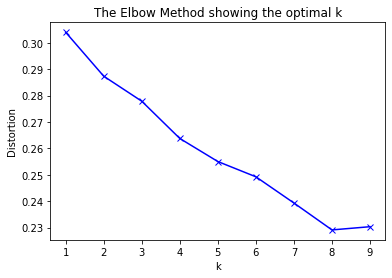

In [167]:
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt

london_grouped_clustering = london_grouped.drop('Neighborhood', 1)

# k means determine k
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(london_grouped_clustering)
    kmeanModel.fit(london_grouped_clustering)
    distortions.append(sum(np.min(cdist(london_grouped_clustering, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / london_grouped_clustering.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

## Clustering Areas

In [144]:
kclusters = 8

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(london_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([6, 0, 7, 7, 3, 6, 3, 0, 6, 6])

In [145]:
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

london_merged = data

london_merged = london_merged.join(neighborhoods_venues_sorted.set_index('Location'), on='Location')

london_merged

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Bexley,SE2,368814,51.492450,0.121270,6.0,Supermarket,Historic Site,Coffee Shop,Train Station,Platform,Convenience Store,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant
1,Crossness,Bexley,SE2,368814,51.492450,0.121270,2.0,Supermarket,Historic Site,Coffee Shop,Train Station,Platform,Convenience Store,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant
2,West Heath,Bexley,SE2,368814,51.492450,0.121270,6.0,Supermarket,Historic Site,Coffee Shop,Train Station,Platform,Convenience Store,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant
3,Acton,Ealing,W3,547488,51.513240,-0.267460,0.0,Grocery Store,Park,Indian Restaurant,Breakfast Spot,Train Station,Gas Station,Fish Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant
4,Addington,Croydon,CR0,347577,51.384755,-0.051499,7.0,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
5,Addiscombe,Croydon,CR0,347577,51.384755,-0.051499,7.0,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
6,Coombe,Croydon,CR0,347577,51.384755,-0.051499,6.0,Indian Restaurant,Italian Restaurant,Food,Pub,Bar,Hotel,Hardware Store,Grocery Store,Gastropub,Pharmacy
7,Croydon,Croydon,CR0,347577,51.384755,-0.051499,7.0,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
8,Forestdale,Croydon,CR0,347577,51.384755,-0.051499,7.0,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
9,New Addington,Croydon,CR0,347577,51.384755,-0.051499,7.0,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market


### Further cleaning the dataset

In [146]:
london_merged.dropna(inplace=True)

In [147]:
london_merged['Cluster Labels'] = london_merged['Cluster Labels'].astype(int)
london_merged.dtypes

Location                   object
London_borough             object
Postcode district          object
Avg price                   int64
Latitude                  float64
Longitude                 float64
Cluster Labels              int32
1st Most Common Venue      object
2nd Most Common Venue      object
3rd Most Common Venue      object
4th Most Common Venue      object
5th Most Common Venue      object
6th Most Common Venue      object
7th Most Common Venue      object
8th Most Common Venue      object
9th Most Common Venue      object
10th Most Common Venue     object
dtype: object

In [148]:
london_merged.drop_duplicates(subset='Postcode district',inplace=True)

In [149]:
london_merged.reset_index(inplace=True)
london_merged.drop(columns='index',inplace=True)

## Showing Cluster on Map

In [150]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=10)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
    
folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(map_clusters)
       
map_clusters

## Choropleth Map for visualizing London Boroughs and Avg Price

In [168]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Avg price'],
    key_on='feature.properties.name',
    fill_color='RdPu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average house Prices'
)
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(lnd_map)

folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(lnd_map)

# display map
lnd_map

## Choropleth Map for visualizing London Boroughs and Clusters

In [152]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 9.5)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Cluster Labels'],
    key_on='feature.properties.name',
    fill_color='PuRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Cluster Labels'
)

folium.GeoJson(london_boroughs, style_function=boroughs_style, name='geojson').add_to(lnd_map)

lnd_map

## Examine all Clusters

In [153]:
london_merged[london_merged['Cluster Labels']==0]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Acton,Ealing,W3,547488,51.513240,-0.267460,0,Grocery Store,Park,Indian Restaurant,Breakfast Spot,Train Station,Gas Station,Fish Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant
6,Anerley,Bromley,SE20,348970,51.410090,-0.056830,0,Supermarket,Convenience Store,Grocery Store,Fast Food Restaurant,Hotel,Flower Shop,Farmers Market,Film Studio,Fish & Chips Shop,Fish Market
10,Ardleigh Green,Havering,RM11,513077,51.583700,0.174760,0,Clothing Store,Furniture / Home Store,Grocery Store,Café,Zoo Exhibit,Flea Market,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop
12,Arnos Grove,Enfield,N11,513066,51.616310,-0.138390,0,Grocery Store,Bus Stop,Beer Bar,Train Station,Fish & Chips Shop,Flower Shop,Fast Food Restaurant,Film Studio,Fish Market,Flea Market
28,Beddington,Sutton,SM6,362501,51.375381,-0.152323,0,Grocery Store,Train Station,Auto Workshop,Restaurant,Zoo Exhibit,Fish Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio
31,Bellingham,Lewisham,SE6,391204,51.437220,-0.018680,0,Grocery Store,Furniture / Home Store,Train Station,Discount Store,Pizza Place,Turkish Restaurant,Zoo Exhibit,Fish Market,Falafel Restaurant,Farmers Market
38,Blackfen,Bexley,DA15,392869,51.452281,0.099797,0,Grocery Store,Bus Stop,Gastropub,Convenience Store,Food Truck,Flea Market,Farmers Market,Fountain,Fast Food Restaurant,Film Studio
48,Brent Park,Brent,NW10,525095,51.539160,-0.251230,0,Grocery Store,Warehouse Store,Fast Food Restaurant,Sandwich Place,Pharmacy,Clothing Store,Convenience Store,Café,Food Service,Fabric Shop
94,East Wickham,Bexley,DA16,404193,51.459075,0.099121,0,Indian Restaurant,Construction & Landscaping,Grocery Store,Pizza Place,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop
100,Enfield Town,Enfield,EN1,442142,51.641312,-0.074635,0,Daycare,Hotel,Tennis Court,Grocery Store,Coffee Shop,Train Station,Construction & Landscaping,Bus Stop,Discount Store,Flower Shop


In [154]:
london_merged[london_merged['Cluster Labels']==1]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
11,Arkley,Barnet,EN5,621064,51.644415,-0.179185,1,Recruiting Agency,Pub,Coffee Shop,Zoo Exhibit,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop
19,Barnes Cray,Bexley,DA1,291203,51.452068,0.172230,1,Pub,Supermarket,Italian Restaurant,Medical Supply Store,Track Stadium,Mediterranean Restaurant,Flea Market,Farmers Market,Fast Food Restaurant,Film Studio
43,Botany Bay,Enfield,EN2,516077,51.653660,-0.110614,1,Lake,Pub,Food,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
49,Brimsdown,Enfield,EN3,350927,51.643220,-0.043790,1,Pub,Playground,Café,Supermarket,Turkish Restaurant,Zoo Exhibit,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant
70,Chislehurst,Bromley,BR7,594775,51.413275,0.087473,1,Gym Pool,Pub,Nature Preserve,Department Store,Fabric Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market
91,East Dulwich,Southwark,SE22,591350,51.452560,-0.070760,1,Bar,Pub,Gastropub,Grocery Store,Park,Bus Stop,Food Service,Food Court,Food & Drink Shop,Food Stand
103,Foots Cray,Bexley,DA14,353322,51.452068,0.172230,1,Pub,Supermarket,Italian Restaurant,Medical Supply Store,Track Stadium,Mediterranean Restaurant,Flea Market,Farmers Market,Fast Food Restaurant,Film Studio
109,Gallows Corner,Havering,RM2,490936,51.475870,0.276066,1,Indian Restaurant,Pub,Fast Food Restaurant,Zoo Exhibit,Flower Shop,Falafel Restaurant,Farmers Market,Film Studio,Fish & Chips Shop,Fish Market
119,Ham,Richmond upon Thames,TW10,766188,51.440750,-0.282088,1,Lake,Tree,Flower Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
141,Kennington,Lambeth,SE11,600318,51.490840,-0.111080,1,Pub,Café,Coffee Shop,Italian Restaurant,Indian Restaurant,Fish & Chips Shop,Gastropub,Pizza Place,Museum,Bar


In [155]:
london_merged[london_merged['Cluster Labels']==2]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
22,Battersea,Wandsworth,SW11,828769,51.467600,-0.162900,2,Café,Indian Restaurant,Pub,Bar,Restaurant,Breakfast Spot,Seafood Restaurant,Supermarket,Sandwich Place,Coffee Shop
23,Bayswater,Westminster,W2,1057096,51.514940,-0.180480,2,Hotel,Café,Coffee Shop,Pub,Italian Restaurant,Garden,Restaurant,French Restaurant,Greek Restaurant,Outdoor Sculpture
24,Beckenham,Bromley,BR3,455860,51.415095,-0.035403,2,Athletics & Sports,Park,Train Station,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market
25,Beckton,Newham,E6,373281,51.532920,0.054610,2,Pub,Turkish Restaurant,Fast Food Restaurant,Supermarket,Chinese Restaurant,Clothing Store,Grocery Store,Sandwich Place,Gym Pool,Bakery
44,Bow,Tower Hamlets,E3,448271,51.527020,-0.025940,2,Pub,Bus Stop,Light Rail Station,Grocery Store,Bar,Locksmith,Park,Burger Joint,Food Stand,Fish & Chips Shop
45,Bowes Park,Haringey,N22,490200,51.602140,-0.112230,2,Italian Restaurant,Indian Restaurant,Park,Light Rail Station,Bar,Dim Sum Restaurant,Diner,Farmers Market,Fast Food Restaurant,Film Studio
47,Brent Cross,Barnet,NW2,556139,51.562370,-0.221310,2,Bus Stop,Supermarket,Clothing Store,Gym / Fitness Center,Convenience Store,Food Stand,Food Service,Food Truck,Food Court,Food & Drink Shop
51,Brockley,Lewisham,SE4,505094,51.462680,-0.035580,2,Convenience Store,Café,Grocery Store,Coffee Shop,Gastropub,Beer Store,Pizza Place,Restaurant,Indian Restaurant,Pakistani Restaurant
55,Burnt Oak,Barnet,HA8,475199,51.604025,-0.262629,2,Bus Stop,Bakery,Wings Joint,Coffee Shop,Sandwich Place,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio
56,"Burroughs, The",Barnet,NW4,519346,51.589120,-0.228100,2,Coffee Shop,Chinese Restaurant,Japanese Restaurant,Turkish Restaurant,Park,Noodle House,Café,Bus Stop,Student Center,Sushi Restaurant


In [156]:
london_merged[london_merged['Cluster Labels']==3]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,Aldborough Hatch,Redbridge,IG2,415224,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
5,Alperton,Brent,HA0,460101,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
26,Becontree,Barking and Dagenham,RM9,317805,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
27,Becontree Heath,Barking and Dagenham,RM8,320000,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
32,Belmont,Harrow,HA3,459331,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
33,Belmont,Sutton,SM2,350331,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
36,Berrylands,Kingston upon Thames,KT5,492102,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
62,Chadwell Heath,Redbridge,RM6,350694,51.57289,0.147528,3,Hookah Bar,Pharmacy,Construction & Landscaping,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market
64,Chase Cross,Havering,RM5,389677,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
65,Chelsfield,Bromley,BR6,544548,51.50642,-0.127210,3,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub


In [157]:
london_merged[london_merged['Cluster Labels']==4]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
40,Blackheath,Lewisham,SE3,516134,51.47138,0.02338,4,Pub,Photography Studio,Zoo Exhibit,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market


In [158]:
london_merged[london_merged['Cluster Labels']==5]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
15,Barking,Barking and Dagenham,IG11,285973,51.53312,0.084077,5,Grocery Store,Spa,Plaza,Supermarket,Zoo Exhibit,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio
16,Barkingside,Redbridge,IG6,462086,51.50642,-0.127210,5,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
17,Barnehurst,Bexley,DA7,422900,51.47052,0.146706,5,Pub,Forest,Indian Restaurant,Convenience Store,Zoo Exhibit,Flea Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio
72,Clapham,Lambeth,SW4,635079,51.46095,-0.139220,5,Pub,Café,Burger Joint,Coffee Shop,Grocery Store,Restaurant,Bar,Gym / Fitness Center,Gastropub,Italian Restaurant
73,Cockfosters,Barnet,EN4,754047,51.50642,-0.127210,5,Hotel,Theater,Art Gallery,Plaza,Garden,Ramen Restaurant,Sandwich Place,Burger Joint,Japanese Restaurant,Pub
74,Colindale,Barnet,NW9,427413,51.58486,-0.248810,5,Asian Restaurant,Café,Auto Workshop,Bus Stop,Coffee Shop,Ice Cream Shop,Pub,Hotel,Hookah Bar,Hardware Store
75,Colliers Wood,Merton,SW19,580568,51.42170,-0.207960,5,Bar,Clothing Store,Pub,Sushi Restaurant,Coffee Shop,Italian Restaurant,Grocery Store,Supermarket,Optical Shop,Indian Restaurant
113,Grange Park,Enfield,N21,568220,51.63519,-0.093030,5,Italian Restaurant,Bus Stop,Grocery Store,Supermarket,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market
131,Highbury,Islington,N5,656031,51.55318,-0.098390,5,Café,Tapas Restaurant,Grocery Store,Bookstore,Cheese Shop,Restaurant,Fish & Chips Shop,Middle Eastern Restaurant,Bar,Park
132,Highgate,Camden,N6,867061,51.57145,-0.149830,5,Pub,Coffee Shop,Bakery,Indian Restaurant,Pizza Place,Park,Bookstore,Gastropub,Tea Room,Plaza


In [159]:
london_merged[london_merged['Cluster Labels']==6]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Bexley,SE2,368814,51.492450,0.121270,6,Supermarket,Historic Site,Coffee Shop,Train Station,Platform,Convenience Store,Zoo Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant
4,Aldwych,Westminster,WC2,1662350,51.516510,-0.119680,6,Pub,Sandwich Place,Café,Theater,Hotel,Japanese Restaurant,Bookstore,Korean Restaurant,Restaurant,Park
7,Angel,Islington,EC1,891819,51.523610,-0.098770,6,Food Truck,Coffee Shop,Pub,Italian Restaurant,Park,Hotel,Gym / Fitness Center,Vietnamese Restaurant,Beer Bar,Breakfast Spot
8,Aperfield,Bromley,TN16,445752,51.271728,0.074711,6,Gym / Fitness Center,Historic Site,Soccer Field,Fish Market,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop
9,Archway,Islington,N19,598216,51.563930,-0.129450,6,Pizza Place,Coffee Shop,Grocery Store,Pub,Italian Restaurant,Café,Vegetarian / Vegan Restaurant,Gastropub,Farmers Market,Thai Restaurant
13,Balham,Wandsworth,SW12,627530,51.448220,-0.148390,6,Coffee Shop,Grocery Store,Pub,Indian Restaurant,Bakery,Restaurant,Cocktail Bar,Sandwich Place,Fast Food Restaurant,Fish & Chips Shop
14,Bankside,Southwark,SE1,906486,51.499960,-0.095680,6,Pub,Coffee Shop,Hotel,Gym / Fitness Center,Garden,Café,Argentinian Restaurant,Theater,Wine Bar,Park
18,Barnes,Richmond upon Thames,SW13,1098276,51.474570,-0.242120,6,Pub,Pizza Place,Farmers Market,Park,Indie Movie Theater,Bakery,French Restaurant,Movie Theater,Food & Drink Shop,Sports Club
20,Barnet Gate,Barnet,NW7,695465,51.615680,-0.245110,6,Grocery Store,Bus Stop,Platform,Juice Bar,Indian Restaurant,Salon / Barbershop,Chinese Restaurant,Pharmacy,Stationery Store,Coffee Shop
21,Barnsbury,Islington,N1,755172,51.529690,-0.086970,6,Coffee Shop,Pub,Breakfast Spot,Cocktail Bar,Burger Joint,Yoga Studio,Restaurant,Vietnamese Restaurant,Café,Gym


In [160]:
london_merged[london_merged['Cluster Labels']==7]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,Addington,Croydon,CR0,347577,51.384755,-0.051499,7,Grocery Store,Art Gallery,Zoo Exhibit,Flower Shop,Farmers Market,Fast Food Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Flea Market
